In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
%config InlineBackend.figure_format = "png"
# plt.style.use("seaborn")
mpl.rcParams["figure.dpi"]= 200

In [3]:
DATA_DIR = "data"
DATA_WT = f"{DATA_DIR}/WT Slide-seq data"
DATA_DIABETES = f"{DATA_DIR}/Diabetes Slide-seq data"

## Data exploration

Data is described [here](https://docs.google.com/document/d/1gKJhFN3hKfMo7CvGcKeWgmFvueWrVGrw5gFr3ddSdMY/edit)

Looking at the WT data, Diabetes has the same format

In [4]:
cell_type_df = pd.read_csv(
    f"{DATA_WT}/WT1/PuckT3_bead_maxct_df.csv", usecols=["barcode", "max_cell_type"]
)
bead_location_df = pd.read_csv(
    f"{DATA_WT}/WT1/BeadLocationsForR_T3_Trimmed.csv", usecols=["barcode", "x", "y"]
)

In [5]:
cell_type_df.head()

,barcode,max_cell_type
0,ACCTTTTTTTTTTT,1
1,CGGGATTTTTTTTT,2
2,CATTCATTTTTTTT,4
3,GGCTACTTTTTTTT,3
4,CTTGATGTTTTTTT,4


In [6]:
bead_location_df.head()

,barcode,x,y
0,ACCTTTTTTTTTTT,2911.083333,3180.472222
1,CGGGATTTTTTTTT,3037.054795,4285.363014
2,CATTCATTTTTTTT,1664.345238,3552.726190
3,GGCTACTTTTTTTT,4048.823204,2583.165746
4,CTTGATGTTTTTTT,3072.972222,2726.277778


In [7]:
def get_cell_type_data(cell_type_df_path, bead_location_df_path):
    df_cell_type = pd.read_csv(cell_type_df_path, usecols=["barcode", "max_cell_type"])
    df_bead_location = pd.read_csv(bead_location_df_path, usecols=["barcode", "x", "y"])
    final = pd.merge(df_cell_type, df_bead_location, on="barcode")
    final.columns = ["barcode", "cell_type", "x", "y"]
    return final

In [8]:
# WT datasets:
df_wt = get_cell_type_data(
    f"{DATA_WT}/WT1/PuckT3_bead_maxct_df.csv",
    f"{DATA_WT}/WT1/BeadLocationsForR_T3_Trimmed.csv",
)
df_wt_2 = get_cell_type_data(
    f"{DATA_WT}/WT2/Puck24_bead_maxct_df.csv",
    f"{DATA_WT}/WT2/BeadLocationsForR_Puck24_Trimmed_cleaned.csv",
)
df_wt_3 = get_cell_type_data(
    f"{DATA_WT}/WT3/Normal_Puck7_bead_maxct_df.csv",
    f"{DATA_WT}/WT3/BeadLocationsForR_Normal_Puck7_Trimmed.csv",
)

# Diabetes datasets:
df_sick = get_cell_type_data(
    f"{DATA_DIABETES}/Diabetes_1/Puck_T4_bead_maxct_df.csv",
    f"{DATA_DIABETES}/Diabetes_1/BeadLocationsForR_T4_Trimmed.csv"
)
df_sick_2 = get_cell_type_data(
    f"{DATA_DIABETES}/Diabetes_2/Diabetes_Puck10_bead_maxct_df.csv",
    f"{DATA_DIABETES}/Diabetes_2/BeadLocationsForR_Diabetes_Puck10_Trimmed.csv"
)
df_sick_3 = get_cell_type_data(
    f"{DATA_DIABETES}/Diabetes_3/Diabetes_Puck11_bead_maxct_df.csv",
    f"{DATA_DIABETES}/Diabetes_3/BeadLocationsForR_Diabetes_Puck11_Trimmed.csv"
)

In [9]:
cell_types = df_wt["cell_type"].unique()

In [10]:
cell_type_name_mapping = {
    1: "ES",
    2: "RS",
    3: "Myoid",
    4: "SPC",
    5: "SPG",
    6: "Sertoli",
    7: "Leydig",
    8: "Endothelial",
    9: "Macrophage",
}

In [110]:
def visualize_data(df, title, ax=None):
#     plt.figure(figsize=(3, 3))
    
    if ax is None:
        fig, ax = plt.subplots(1,1, figsize=(3,3))
        
    ax.set_facecolor("white")

    for cell_type in cell_types:
        cell_type_df = df[df["cell_type"] == cell_type]
        ax.scatter(
            cell_type_df.x,
            cell_type_df.y,
            s=0.3,
            cmap=plt.cm.cividis,
            label=cell_type_name_mapping[cell_type],
        )

    ax.set_title(title, fontsize=6.5)
#     plt.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.legend(bbox_to_anchor=(1, 1), fontsize=4)
#     plt.show()

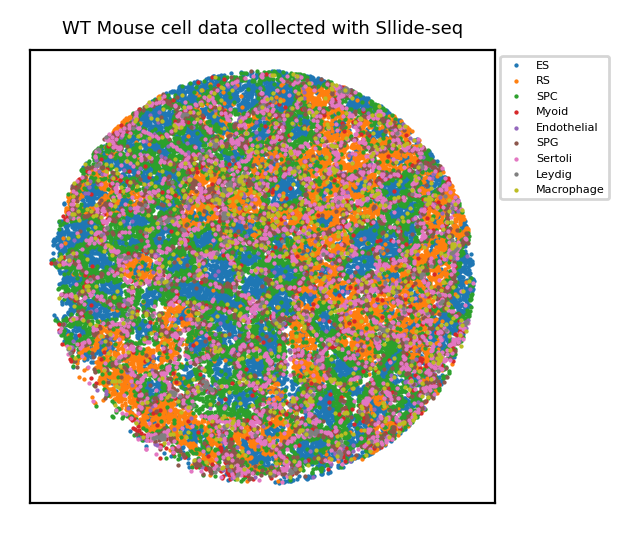

In [111]:
visualize_data(df_wt, "WT Mouse cell data collected with Sllide-seq")

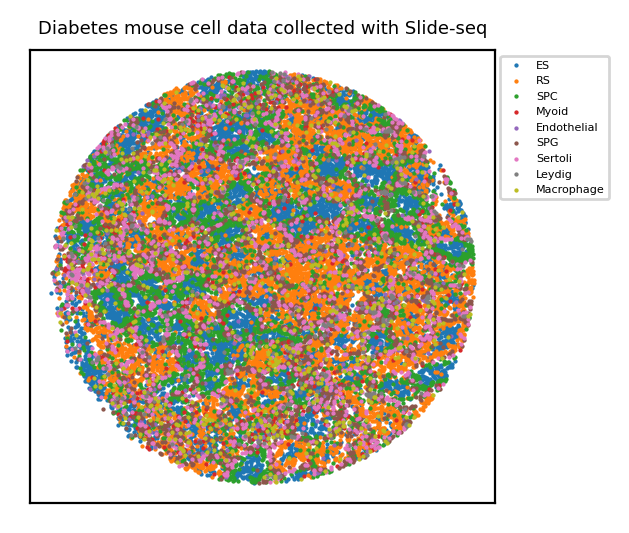

In [112]:
visualize_data(df_sick, "Diabetes mouse cell data collected with Slide-seq")

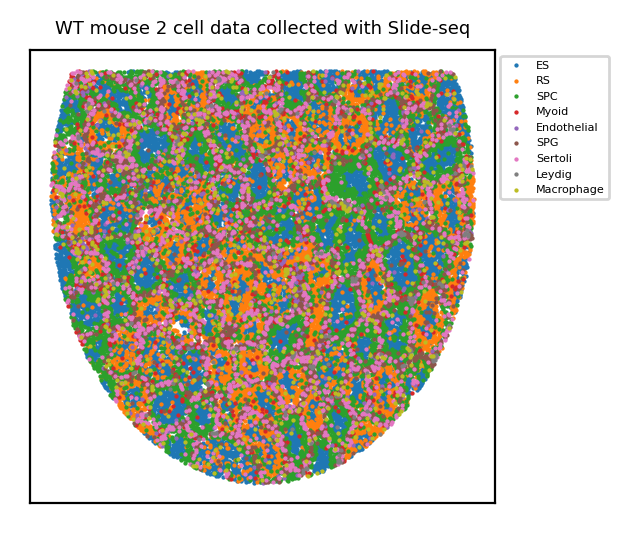

In [113]:
visualize_data(df_wt_2, "WT mouse 2 cell data collected with Slide-seq")

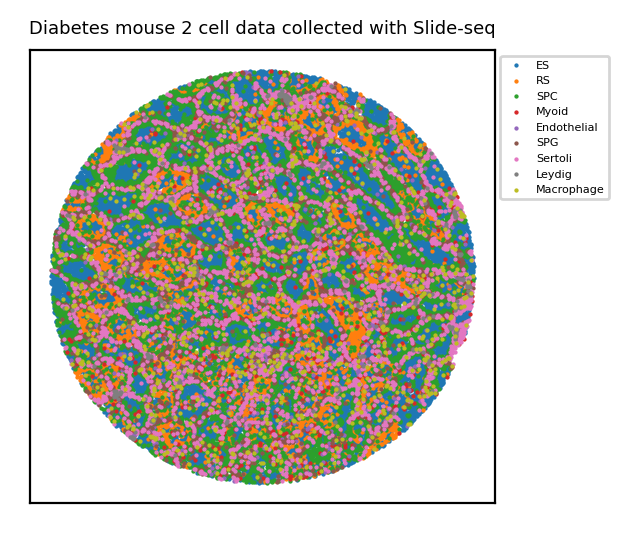

In [114]:
visualize_data(df_sick_2, "Diabetes mouse 2 cell data collected with Slide-seq")

# Data Analysis 

In [13]:
df_wt.head()

,barcode,cell_type,x,y
0,ACCTTTTTTTTTTT,1,2911.083333,3180.472222
1,CGGGATTTTTTTTT,2,3037.054795,4285.363014
2,CATTCATTTTTTTT,4,1664.345238,3552.726190
3,GGCTACTTTTTTTT,3,4048.823204,2583.165746
4,CTTGATGTTTTTTT,4,3072.972222,2726.277778


## Neighborhood Composition Vector Analysis

Get Neighborhood Composition Vectors Pipeline

In [14]:
import typing
from sklearn.neighbors import KDTree
from sklearn.preprocessing import OneHotEncoder
import matplotlib.pyplot as plt

In [15]:
def one_hot_encode_cell_types(df: pd.DataFrame) -> np.ndarray:
    return OneHotEncoder().fit_transform(df[["cell_type"]]).toarray()

In [16]:
def one_hot_encode_cell_types_add_noise(df: pd.DataFrame) -> np.ndarray:
    one_hot = OneHotEncoder().fit_transform(df[["cell_type"]]).toarray()
    noise= np.random.uniform(low=0., high=0.03, size=one_hot.shape)
    return one_hot + noise

In [17]:
def find_k_neighbors(df: pd.DataFrame, n_neighbors: int) -> np.ndarray:
    X_coords = df[["x", "y"]].to_numpy()
    tree = KDTree(X_coords[:, :2], leaf_size=2)
    # Getting distances and indexes of each cell k-neighbors
    unused_distances, indexes = tree.query(X_coords[:, :2], k=n_neighbors)
    return indexes, X_coords

In [18]:
def get_ncvs(df: pd.DataFrame, n_neighbors: int) -> typing.Tuple[np.ndarray, np.ndarray]:
    one_hot_cell_types = one_hot_encode_cell_types(df)
    neighbor_indexes, X_coords = find_k_neighbors(df, n_neighbors)
    one_hot_neigbhors = one_hot_cell_types[neighbor_indexes]
    return one_hot_neigbhors.mean(axis=1), X_coords

In [19]:
def get_ncvs_with_noise(df: pd.DataFrame, n_neighbors: int) -> typing.Tuple[np.ndarray, np.ndarray]:
    one_hot_cell_types = one_hot_encode_cell_types_add_noise(df)
    neighbor_indexes, X_coords = find_k_neighbors(df, n_neighbors)
    one_hot_neigbhors = one_hot_cell_types[neighbor_indexes]
    return one_hot_neigbhors.mean(axis=1), X_coords

Visualize NCV outputs

In [20]:
def plot_ncvs(X_ncvs: np.ndarray, X_coords: np.ndarray, title: str):
    fig, axs = plt.subplots(figsize=(5, 5), nrows=3, ncols=3)

    for i in range(X_ncvs.shape[1]):
        ax = axs.reshape(X_ncvs.shape[1])[i]
        ax.scatter(x=X_coords[:, 0], y=X_coords[:, 1], c=X_ncvs[:, i], s=0.05)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(
            f"With respect to {cell_type_name_mapping[i + 1]} cell type", fontsize=4
        )

    fig.suptitle(title)
    plt.show()

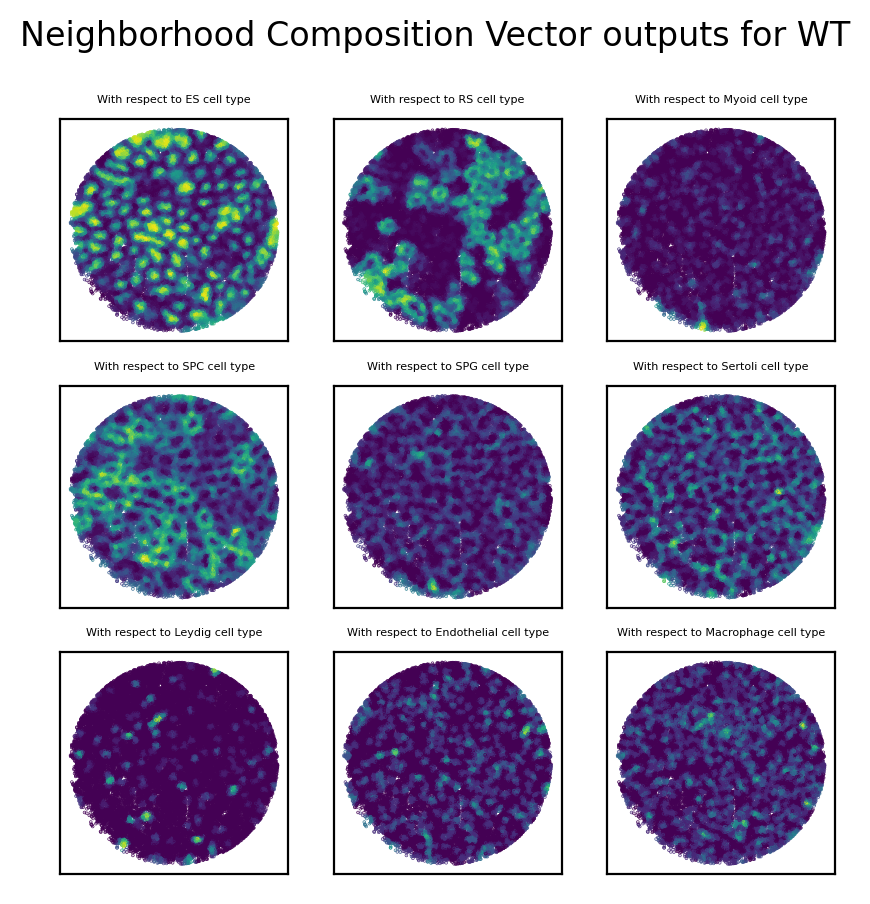

In [21]:
X_ncvs, X_coords = get_ncvs(df_wt, n_neighbors=40)
plot_ncvs(X_ncvs, X_coords, title="Neighborhood Composition Vector outputs for WT")

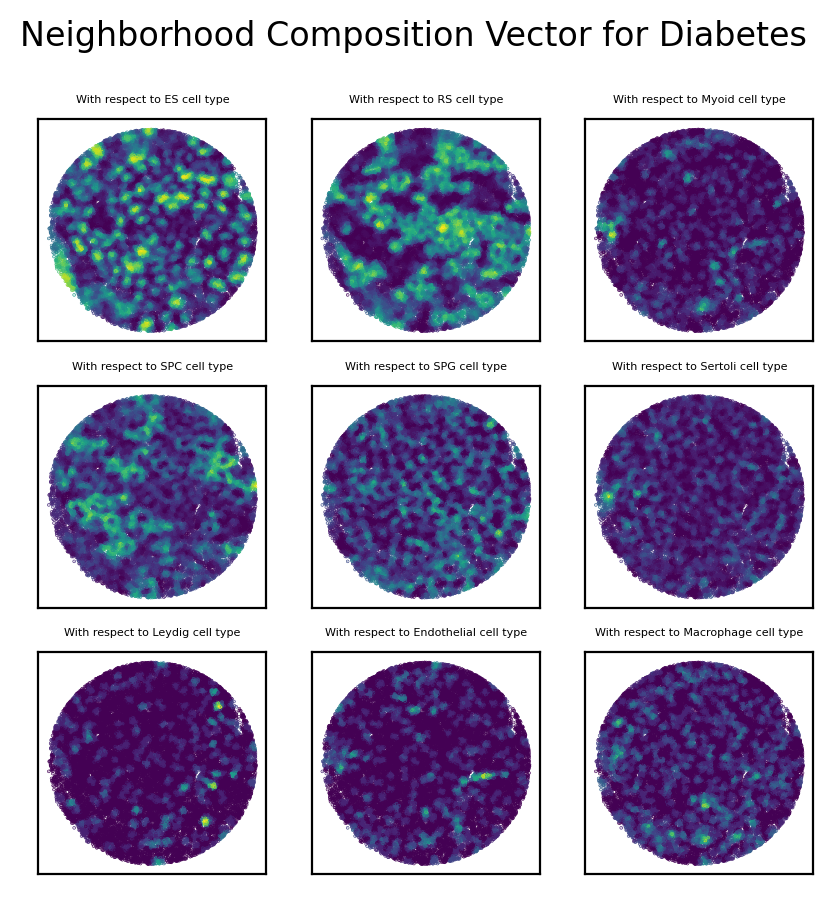

In [22]:
X_ncvs, X_coords = get_ncvs(df_sick, n_neighbors=40)
plot_ncvs(X_ncvs, X_coords, title="Neighborhood Composition Vector for Diabetes")

In [23]:
from umap import UMAP
import hdbscan
from sklearn.preprocessing import MinMaxScaler

In [24]:
def umap_embedding_3_color_channels(X_ncvs: np.ndarray) -> np.ndarray:
    embedding = UMAP(n_neighbors=5, n_components=3).fit_transform(X_ncvs)
    # Normalize data and return
    return MinMaxScaler().fit_transform(embedding)

In [25]:
def get_rgb_umap(df: pd.DataFrame, n_neighbors: int) -> typing.Tuple[np.ndarray, np.ndarray]:
    X_ncvs, X_coords = get_ncvs(df, n_neighbors=n_neighbors)
    X_umap_rgb = umap_embedding_3_color_channels(X_ncvs)
    return X_umap_rgb, X_coords

In [26]:
def plot_umap_rgb(X_umap_rgb: np.ndarray, X_coords: np.ndarray, title: str):
    plt.figure(figsize=(3, 3))
    plt.scatter(x=X_coords[:, 0], y=X_coords[:, 1], c=np.round(X_umap_rgb, 4), s=0.3)
    plt.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
    plt.title(title, fontsize=8)
    plt.show()

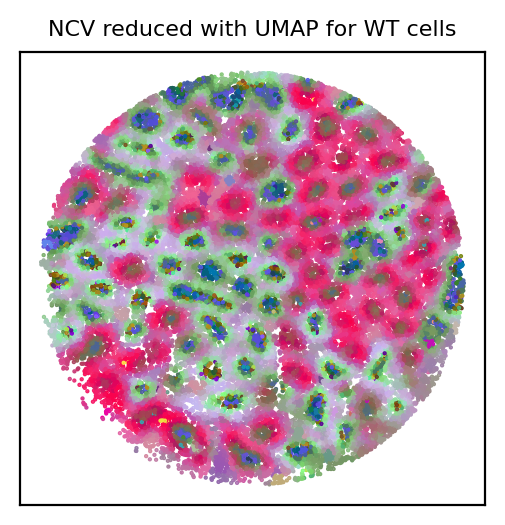

In [28]:
X_umap_rgb, X_coords = get_rgb_umap(df_wt, n_neighbors=40)
plot_umap_rgb(X_umap_rgb, X_coords, title="NCV reduced with UMAP for WT cells")

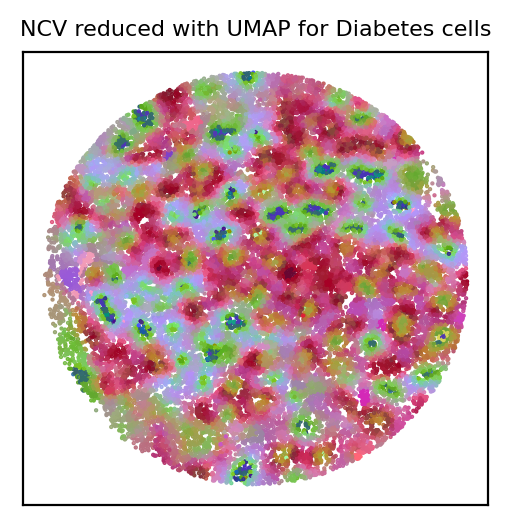

In [31]:
X_umap_rgb, X_coords = get_rgb_umap(df_sick, n_neighbors=40)
plot_umap_rgb(X_umap_rgb, X_coords, title="NCV reduced with UMAP for Diabetes cells")

### UMAP dimensionality reduction HDBSCAN clustering analysis

In [59]:
def umap_embedding_2d_points_and_cluster(
    X_ncvs: np.ndarray, verbose: bool = False
) -> typing.Tuple[np.ndarray, np.ndarray]:
    embedding_2d = UMAP(n_neighbors=50, n_components=2, min_dist=0.5).fit_transform(
        X_ncvs
    )
    hdbscan_labels = hdbscan.HDBSCAN(min_cluster_size=1000).fit_predict(embedding_2d)
    if verbose:
        clustered = hdbscan_labels >= 0
        print(
            f"Number of clusters (inluding noise cluster): {len(np.unique(hdbscan_labels))}",
            f"Number of clustered data points: {len(hdbscan_labels[clustered])}",
            f"Number of noise data points: {len(hdbscan_labels[~clustered])}",
            f"Noise data percentage: {np.round(1 - (np.sum(clustered) / embedding_2d.shape[0]), 4) * 100}%",
            sep="\n",
        )
    return (embedding_2d, hdbscan_labels)

In [77]:
def umap_embedding_2d_points_2_sets(
    X_ncvs_1: np.ndarray, X_ncvs_2: np.ndarray, verbose: bool = False
) -> typing.Tuple[np.ndarray, np.ndarray, np.ndarray, np.ndarray]:
    X_ncvs_total = np.concatenate([X_ncvs_1, X_ncvs_2])
    concat_border = X_ncvs_1.shape[0]
    embedding_2d, hdbscan_labels = umap_embedding_2d_points_and_cluster(
        X_ncvs_total, verbose
    )
    return (
        embedding_2d[:concat_border],
        hdbscan_labels[:concat_border],
        embedding_2d[concat_border:],
        hdbscan_labels[concat_border:],
    )

In [84]:
def umap_2_datasets(df_1, df_2, n_neighbors):
    X_ncvs_1, X_coords_1 = get_ncvs(df_1, n_neighbors=n_neighbors)
    X_ncvs_2, X_coords_2 = get_ncvs(df_2, n_neighbors=n_neighbors)
    embedding_1, lables_1, embedding_2, lables_2 = umap_embedding_2d_points_2_sets(
        X_ncvs_1, X_ncvs_2, verbose=True
    )
    return (
        X_coords_1, embedding_1, lables_1,
        X_coords_2, embedding_2, lables_2
    )

In [213]:
def umap_2_datasets_with_noise(df_1, df_2, n_neighbors):
    X_ncvs_1, X_coords_1 = get_ncvs_with_noise(df_1, n_neighbors=n_neighbors)
    X_ncvs_2, X_coords_2 = get_ncvs_with_noise(df_2, n_neighbors=n_neighbors)
    embedding_1, lables_1, embedding_2, lables_2 = umap_embedding_2d_points_2_sets(
        X_ncvs_1, X_ncvs_2, verbose=True
    )
    return (
        X_coords_1, embedding_1, lables_1,
        X_coords_2, embedding_2, lables_2
    )

In [85]:
X_coords_1, embedding_1, labels_1, X_coords_2, embedding_2, labels_2 = umap_2_datasets(
    df_wt, df_sick, n_neighbors=15
)

Number of clusters (inluding noise cluster): 6
Number of clustered data points: 58057
Number of noise data points: 796
Noise data percentage: 1.35%


In [133]:
def plot_embeddings(ax, embedding_2d, labels, c, title=None):
    clustered = labels >= 0
    ax.scatter(
        x=embedding_2d[~clustered, 0],
        y=embedding_2d[~clustered, 1],
        s=0.5,
        color=(0.5, 0.5, 0.5),
        alpha=0.1,
        marker=".",
    )
    ax.scatter(
        x=embedding_2d[clustered, 0],
        y=embedding_2d[clustered, 1],
        s=0.001,
        c=c,
        cmap="Spectral",
        marker=".",
    )
    ax.set_xticks([])
    ax.set_yticks([])
    if title:
        ax.set_title(title, fontsize=4)

In [393]:
data_calculated = []

Number of clusters (inluding noise cluster): 13
Number of clustered data points: 48266
Number of noise data points: 10587
Noise data percentage: 17.990000000000002%
Number of clusters (inluding noise cluster): 10
Number of clustered data points: 47916
Number of noise data points: 10937
Noise data percentage: 18.58%
Number of clusters (inluding noise cluster): 2
Number of clustered data points: 58853
Number of noise data points: 0
Noise data percentage: 0.0%
Number of clusters (inluding noise cluster): 3
Number of clustered data points: 50790
Number of noise data points: 8063
Noise data percentage: 13.700000000000001%
Number of clusters (inluding noise cluster): 1
Number of clustered data points: 0
Number of noise data points: 58853
Noise data percentage: 100.0%


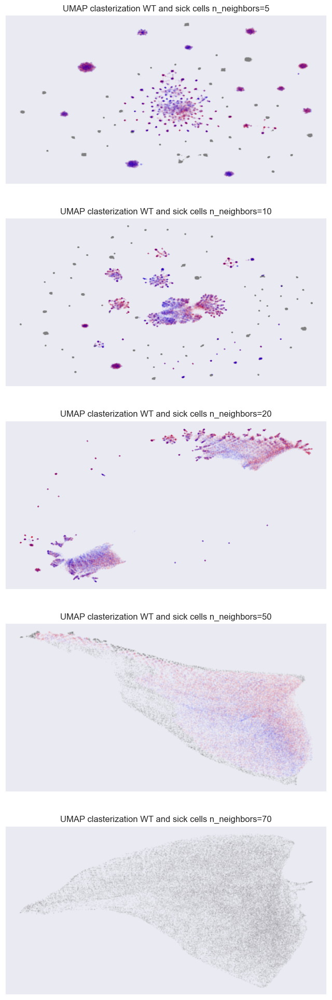

In [394]:
fig, axs = plt.subplots(nrows=5, ncols=1, figsize=(8, 25))

for i, n_neighbors in enumerate([5, 10, 20, 50, 70]):
    (
        X_coords_1,
        embedding_1,
        labels_1,
        X_coords_2,
        embedding_2,
        labels_2,
    ) = umap_2_datasets(df_wt, df_sick, n_neighbors=n_neighbors)
    data_calculated.append(
        (X_coords_1, embedding_1, labels_1, X_coords_2, embedding_2, labels_2)
    )
    plot_embeddings(axs[i], embedding_1, labels_1, "red")
    plot_embeddings(
        axs[i],
        embedding_2,
        labels_2,
        "blue",
        title=f"UMAP clasterization WT and sick cells n_neighbors={n_neighbors}",
    )

Number of clusters (inluding noise cluster): 13
Number of clustered data points: 36997
Number of noise data points: 21856
Noise data percentage: 37.14%
Number of clusters (inluding noise cluster): 4
Number of clustered data points: 39909
Number of noise data points: 18944
Noise data percentage: 32.190000000000005%
Number of clusters (inluding noise cluster): 1
Number of clustered data points: 0
Number of noise data points: 58853
Noise data percentage: 100.0%
Number of clusters (inluding noise cluster): 1
Number of clustered data points: 0
Number of noise data points: 58853
Noise data percentage: 100.0%
Number of clusters (inluding noise cluster): 1
Number of clustered data points: 0
Number of noise data points: 58853
Noise data percentage: 100.0%


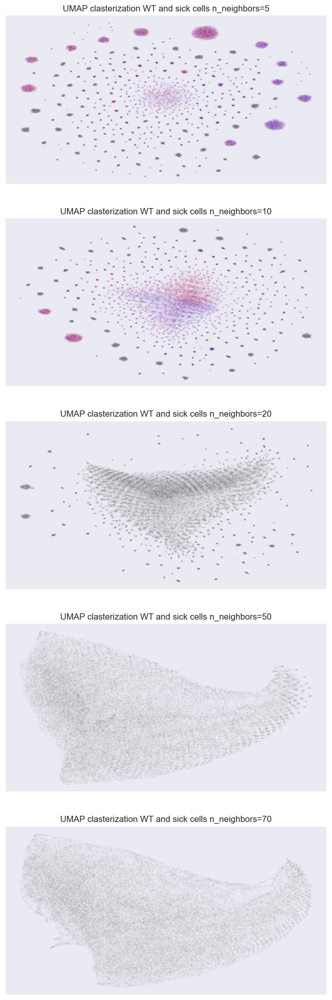

In [395]:
fig, axs = plt.subplots(nrows=5, ncols=1, figsize=(8, 25))

for i, n_neighbors in enumerate([5, 10, 20, 50, 70]):
    (
        X_coords_1,
        embedding_1,
        labels_1,
        X_coords_2,
        embedding_2,
        labels_2,
    ) = umap_2_datasets_with_noise(df_wt, df_sick, n_neighbors=n_neighbors)
    data_calculated.append(
        (X_coords_1, embedding_1, labels_1, X_coords_2, embedding_2, labels_2)
    )
    plot_embeddings(axs[i], embedding_1, labels_1, "red")
    plot_embeddings(
        axs[i],
        embedding_2,
        labels_2,
        "blue",
        title=f"UMAP clasterization WT and sick cells n_neighbors={n_neighbors}",
    )

In [417]:
import seaborn as sns
mpl.rcParams["figure.dpi"]= 300



def plot_umap_dist(data_list, n_neighbors):
    df_dist = pd.DataFrame(columns=["hdbscan_label", "cell_status", "n_neighbors"])

    for data, n_neighbors in zip(data_list, n_neighb):
        X_coords_1, embedding_1, labels_1, X_coords_2, embedding_2, labels_2 = data
        df_dist = df_dist.append(pd.DataFrame({"hdbscan_label": np.concatenate((labels_1, labels_2)), "cell_status": np.concatenate((np.full(labels_1.shape[0], 1), np.full(labels_2.shape[0], 0))), "n_neighbors": n_neighbors}))

    sns.displot(df_dist, x="hdbscan_label", hue="cell_status", multiple="dodge", col="n_neighbors")
    plt.show()

**Plot cell types (Diabetes=0, WT=1) distributed over different UMAP clusters**

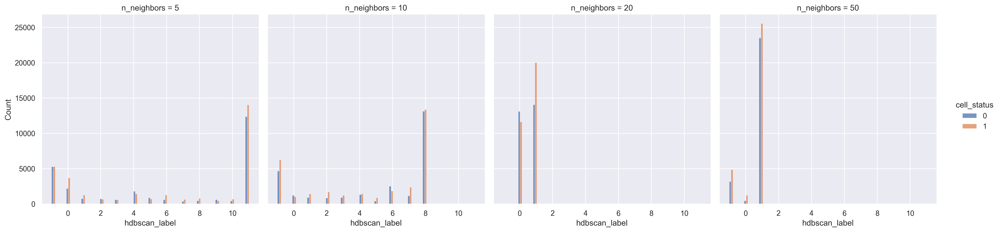

In [418]:
plot_umap_dist(data_calculated[:4], n_neighbors=[5, 10, 20, 50])

**Plot cell types (Diabetes=0, WT=1) distributed over different UMAP clusters with noise data**

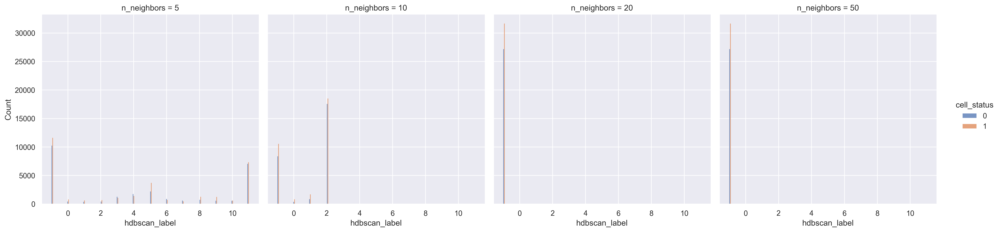

In [419]:
plot_umap_dist(data_calculated[5:-1], [5, 10, 20, 50])

No correlation between hdbscan_label and cell status was found

Apply Leiden algorithm to cluster cells

In [27]:
from anndata import AnnData
import scanpy as sc

X_ncvs_wt, X_coords_wt = get_ncvs(df_wt, 20)
X_ncvs_sick, X_coords_sick = get_ncvs(df_sick, 20)
X = np.concatenate((X_ncvs_wt, X_ncvs_sick))
y = np.concatenate((np.full(X_ncvs_wt.shape[0], 1), np.full(X_ncvs_sick.shape[0], 0)))
adata = AnnData(X)

In [27]:
adata.obs["cell_status"] = y

In [28]:
sc.pp.neighbors(adata, n_neighbors=50)

In [29]:
sc.tl.umap(adata, min_dist=1.)

In [30]:
sc.tl.leiden(adata) #resolution=0.003)

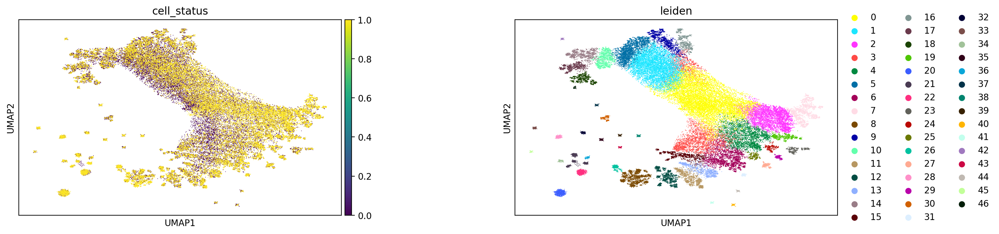

In [31]:
sc.pl.umap(adata, color=["cell_status", "leiden"], wspace=0.4)

In [28]:
import seaborn as sns

In [37]:
adata_collected = {}

Searching for the best UMAP parameters

In [38]:
umap_min_dists = [1., 0.8, 0.5, 0.15, 0.0115]
umap_spread = [0.1, 0.3, 0.5, 0.8, 1.]

for umap_min_dist, umap_spread in zip(umap_min_dists, umap_spread):
    for n_neighbors in [10, 20, 50, 100]:
        X_ncvs_wt, X_coords_wt = get_ncvs(df_wt, n_neighbors)
        X_ncvs_sick, X_coords_sick = get_ncvs(df_sick, n_neighbors)
        X = np.concatenate((X_ncvs_wt, X_ncvs_sick))
        y = np.concatenate(
            (np.full(X_ncvs_wt.shape[0], 1), np.full(X_ncvs_sick.shape[0], 0))
        )
        adata = AnnData(X)
        adata.obs["cell_status"] = y

        sc.pp.neighbors(adata, n_neighbors=50)
        sc.tl.umap(adata, min_dist=umap_min_dist, spread=umap_spread)
        sc.tl.leiden(adata, resolution=1.0)
        
        key_name = f"md_{umap_min_dist}__s_{umap_spread}"
        
        if not adata_collected.get(key_name, False):
            adata_collected[key_name] = []
            
        adata_collected[key_name].append(adata)

/Users/ai/opt/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:829: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
/Users/ai/opt/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:829: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
/Users/ai/opt/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:829: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
/Users/ai/opt/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:829: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


Change Leiden Resolution

In [87]:
umap_min_dists = [1., 0.8, 0.5, 0.15, 0.0115]
umap_spread = [0.1, 0.3, 0.5, 0.8, 1.]

for umap_min_dist, umap_spread in zip(umap_min_dists, umap_spread):
    for i, n_neighbors in enumerate([10, 20, 50, 100]):        
        key_name = f"md_{umap_min_dist}__s_{umap_spread}"
        adata = adata_collected[key_name][i]
        sc.tl.leiden(adata, resolution=0.8)
        adata_collected[key_name][i] = adata
        print("horay")

horay
horay
horay
horay
horay
horay
horay
horay
horay
horay
horay
horay
horay
horay
horay
horay
horay
horay
horay
horay


In [51]:
adata_collected.keys()

dict_keys(['md_1.0__s_0.1', 'md_0.8__s_0.3', 'md_0.5__s_0.5', 'md_0.15__s_0.8', 'md_0.0115__s_1.0'])

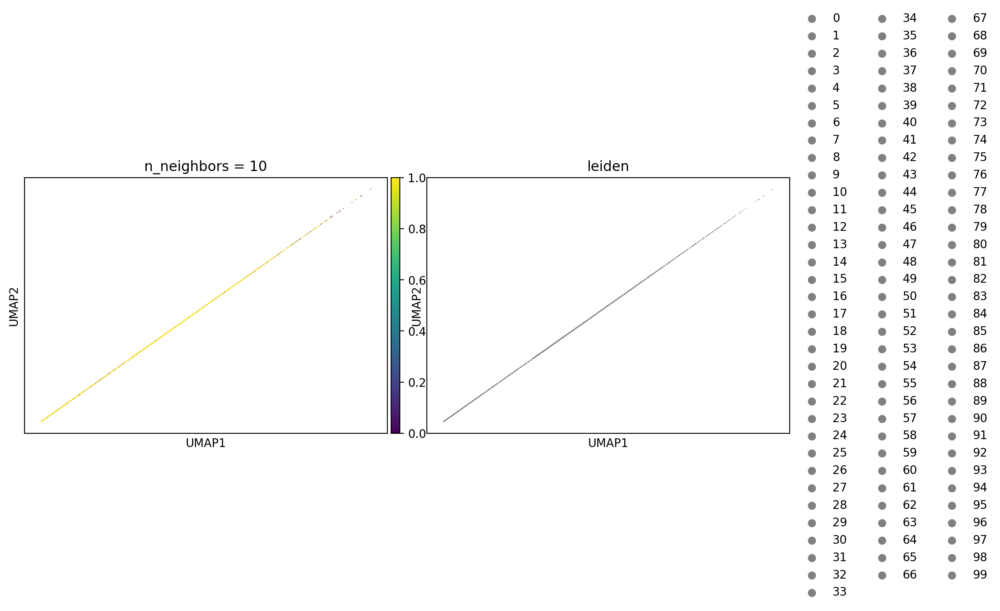

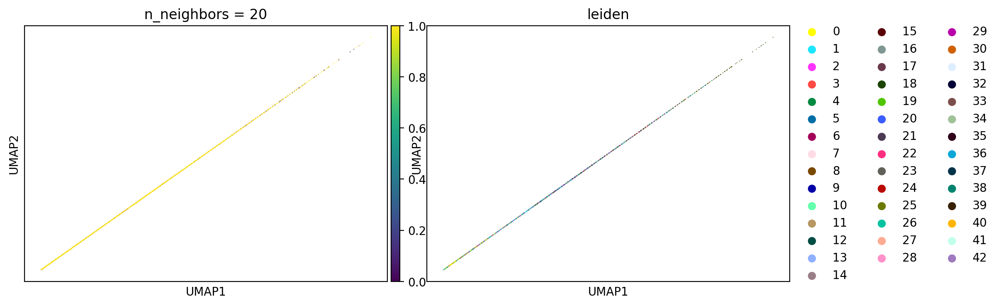

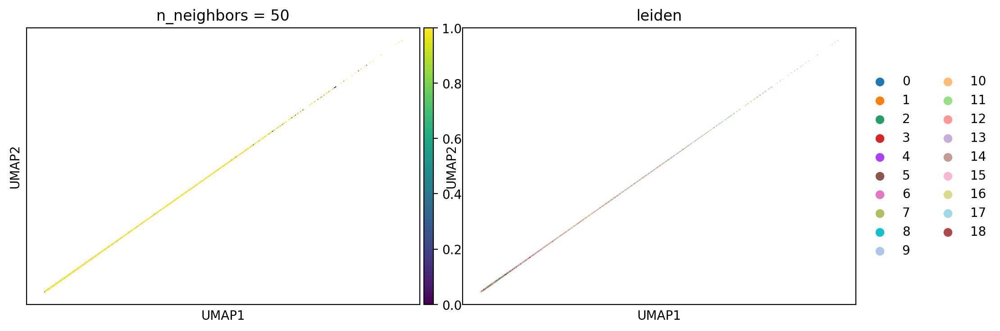

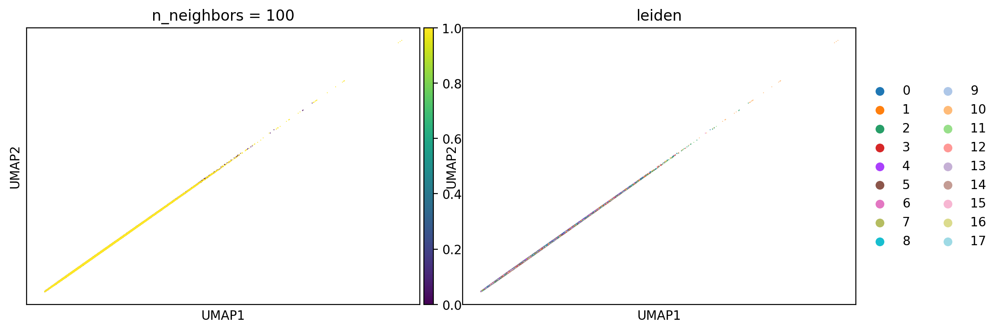

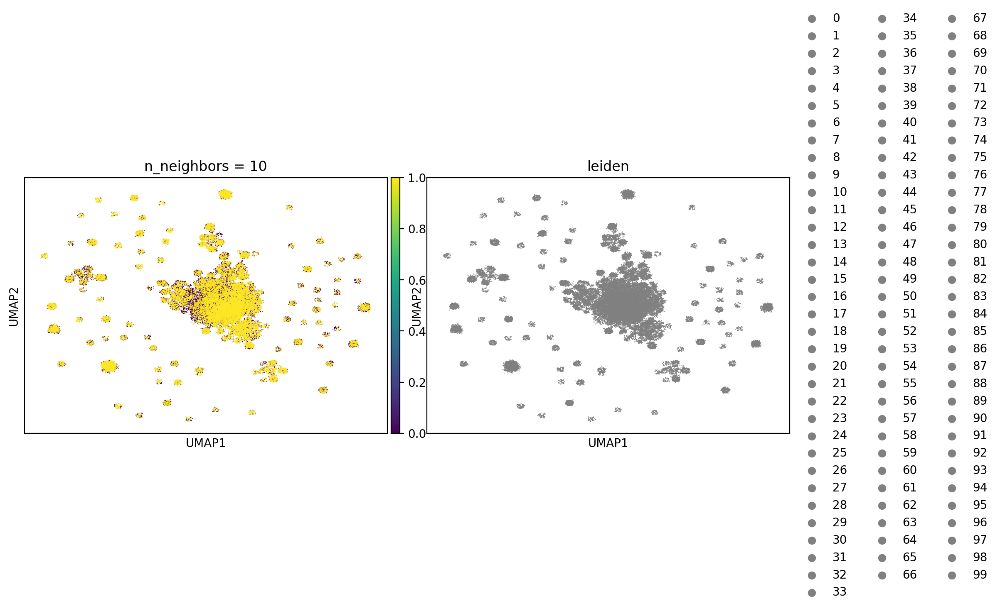

...

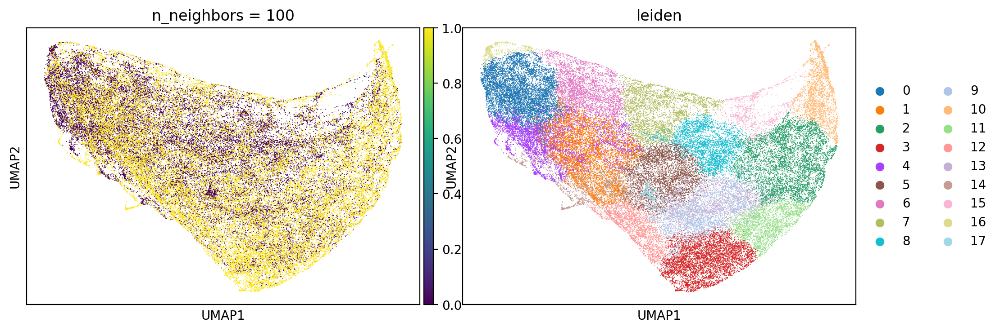

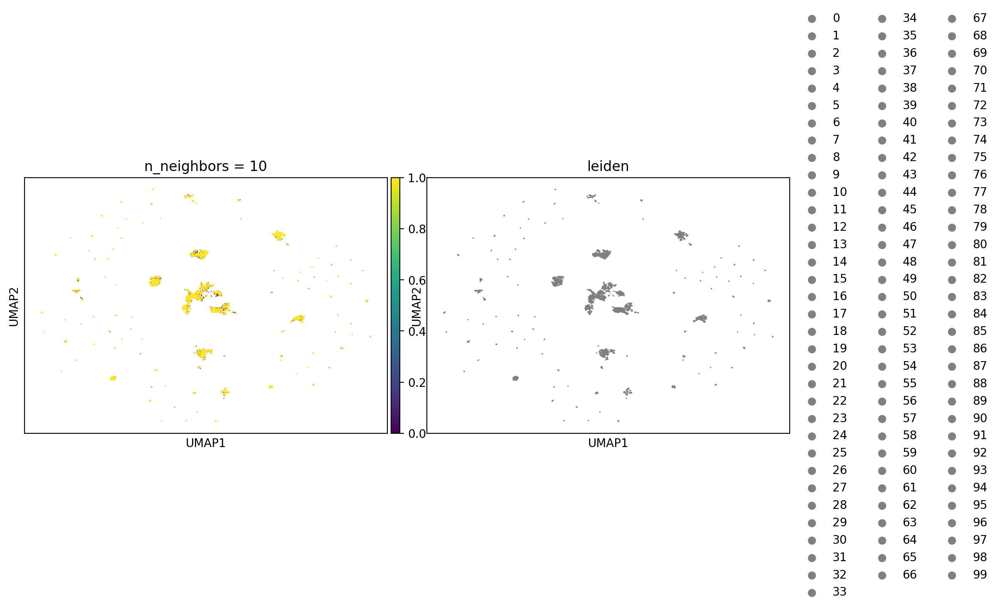

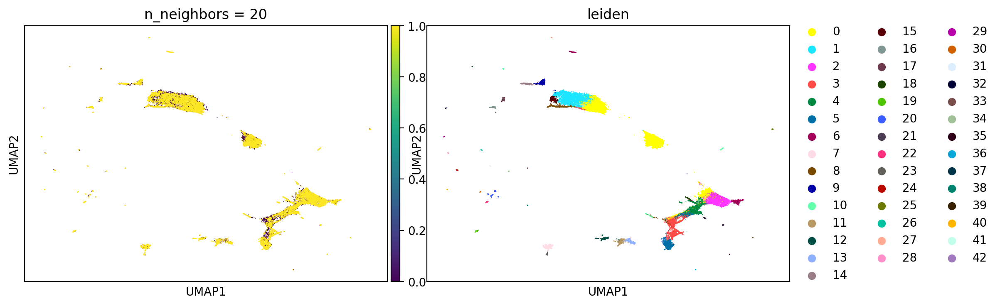

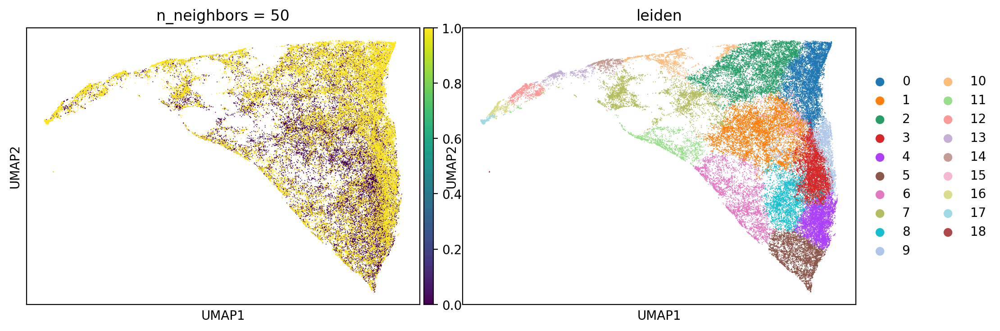

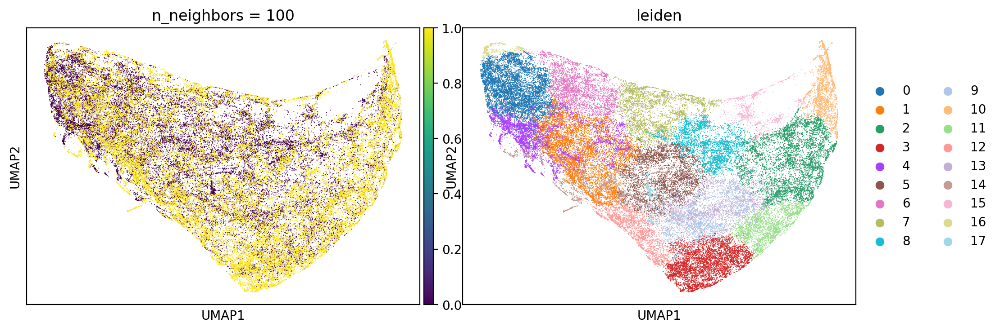

In [88]:
for adata_key in list(adata_collected.keys()):
    for n_neighbors, adata in zip([10, 20, 50, 100], adata_collected[adata_key]):
        sc.pl.umap(
            adata, 
            color=["cell_status", "leiden"],
            wspace=0.01,
            title=f"n_neighbors = {n_neighbors}",
            save=f"__{adata_key}__nn_{n_neighbors}.png"
        )

In [89]:
import os
for adata_key in list(adata_collected.keys()):
    dir_name = f"figures/details/{adata_key}"
    
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)

    for n_neighbors, adata in zip([10, 20, 50, 100], adata_collected[adata_key]):
        umap_points = dict(adata.obsm)["X_umap"]
        cell_status = adata.obs["cell_status"].values

        plt.scatter(x=umap_points[cell_status == 0][:, 0], y=umap_points[cell_status == 0][:, 1], alpha=0.02, c="orange", s=0.5)
        plt.scatter(x=umap_points[cell_status == 1][:, 0], y=umap_points[cell_status == 1][:, 1], alpha=0.02, c="purple", s=0.5)
        plt.savefig(f"figures/details/{adata_key}/n_neighbors_{n_neighbors}__full.png", dpi=300)
        plt.clf()
        plt.scatter(x=umap_points[cell_status == 0][:, 0], y=umap_points[cell_status == 0][:, 1], alpha=1, c="orange", s=0.5)
        plt.savefig(f"figures/details/{adata_key}/n_neighbors_{n_neighbors}__sick.png", dpi=300)
        plt.clf()
        plt.scatter(x=umap_points[cell_status == 1][:, 0], y=umap_points[cell_status == 1][:, 1], alpha=1, c="purple", s=0.5)
        plt.savefig(f"figures/details/{adata_key}/n_neighbors_{n_neighbors}__helathy.png", dpi=300)
        plt.clf()
# plt.show()

<Figure size 1200x800 with 0 Axes>

In [119]:
adata_collected["md_0.5__s_0.5"][0].write("saved_umap")

In [120]:
for adata_key in list(adata_collected.keys()):
    dir_name = "saved_data"
    
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)

    for n_neighbors, adata in zip([10, 20, 50, 100], adata_collected[adata_key]):
        adata.write(f"saved_data/{adata_key}__n_neighbors_{n_neighbors}")

In [118]:
good_clusters = adata_collected["md_0.5__s_0.5"][0].obs["leiden"]#.map(lambda x: x if int(x) > 100 else 0)

In [108]:
good_clusters.value_counts().map(lambda x: x if x > 100 else 0).index

CategoricalIndex(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11',
                  '12', '13', '14', '15', '16', '17', '18', '19', '20', '21',
                  '22', '23', '24', '25', '26', '27', '28', '29', '30', '31',
                  '32', '33', '34', '35', '36', '37', '38', '39', '40', '41',
                  '42', '43', '44', '45', '46', '47', '48', '49', '50', '51',
                  '52', '53', '54', '55', '56', '57', '58', '61', '60', '59',
                  '62', '63', '64', '65', '66', '67', '68', '69', '71', '70',
                  '73', '72', '74', '75', '76', '77', '78', '79', '80', '81',
                  '82', '83', '85', '84', '86', '87', '88', '89', '90', '91',
                  '92', '93', '94', '95', '96', '97', '98', '99'],
                 categories=['0', '1', '2', '3', '4', '5', '6', '7', ...], ordered=False, dtype='category')

In [114]:
df_dist = pd.DataFrame(columns=("leiden", "cell_status", "n_neighbors"))
for adata, n_neighbors in zip(adata_obs_collected, [10, 20, 50, 100, 150]):
    df_dist = df_dist.append(
        pd.DataFrame(
            {
                "leiden": adata.obs["leiden"],
                "cell_status": adata.obs["cell_status"],
                "n_neighbors": n_neighbors,
            }
        ),
        ignore_index=True,
    )

In [101]:
mpl.rcParams["figure.dpi"]= 70
def plot_dist(df):
    sns.displot(
        df,
        x="leiden",
        hue="cell_status",
        multiple="dodge",
        col="n_neighbors",
    )
    plt.show()

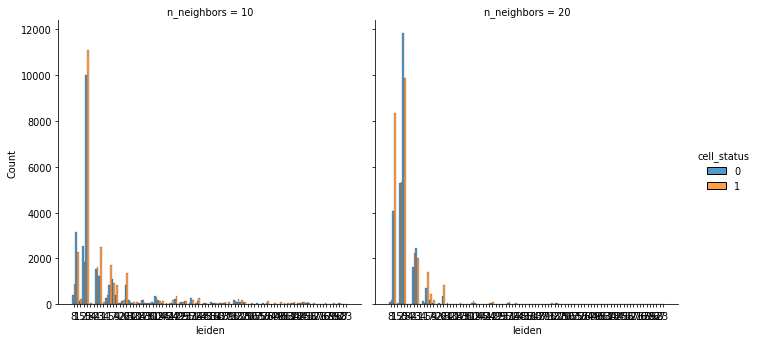

In [115]:
plot_dist(df_dist[df_dist["n_neighbors"] < 30])

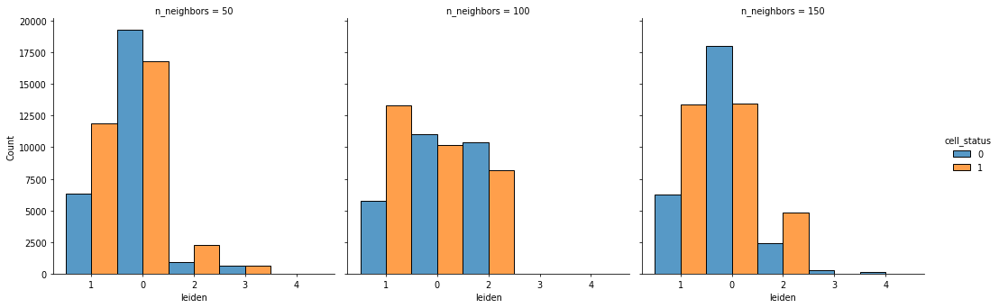

In [116]:
plot_dist(df_dist[df_dist["n_neighbors"] > 30])

In [122]:
from scipy.stats import ttest_ind, ttest_rel

for n_neighbors in [10, 20, 50, 100, 150]:
    df_gr = (
        df_dist[df_dist["n_neighbors"] == n_neighbors]
        .groupby(["cell_status", "leiden"])
        .size()
        .unstack()
        .T
        .fillna(0)
    )

    stat, p = ttest_ind(df_gr[0], df_gr[1])
    print(f"=== T-test for n_neigbors = {n_neighbors} ===")
    print("t-stat=%.3f, p=%.3f" % (stat, p))
    if p > 0.05:
        print("Probably the same distribution")
    else:
        print("Probably different distributions")

=== T-test for n_neigbors = 10 ===
t-stat=-0.280, p=0.780
Probably the same distribution
=== T-test for n_neigbors = 20 ===
t-stat=-0.241, p=0.811
Probably the same distribution
=== T-test for n_neigbors = 50 ===
t-stat=-0.180, p=0.862
Probably the same distribution
=== T-test for n_neigbors = 100 ===
t-stat=-0.670, p=0.539
Probably the same distribution
=== T-test for n_neigbors = 150 ===
t-stat=-0.199, p=0.847
Probably the same distribution


In [121]:
df_dist[df_dist["n_neighbors"] == 150].groupby(["cell_status", "leiden"]).size().unstack().T.fillna(0)

cell_status,0,1
leiden,,
0,17973.0,13432.0
1,6300.0,13354.0
2,2420.0,4822.0
3,315.0,51.0
4,186.0,0.0


In [124]:
N_NEIGHBORS = 50

In [125]:
X_ncvs_wt, X_coords_wt = get_ncvs(df_wt, N_NEIGHBORS)
X_ncvs_sick, X_coords_sick = get_ncvs(df_sick, N_NEIGHBORS)

X_ncvs_wt_2, X_coords_wt_2 = get_ncvs(df_wt_2, N_NEIGHBORS)
X_ncvs_sick_2, X_coords_sick_2 = get_ncvs(df_sick_2, N_NEIGHBORS)

In [126]:
X = np.concatenate((X_ncvs_wt, X_ncvs_sick, X_ncvs_wt_2, X_ncvs_sick_2))
y = np.concatenate((np.full(X_ncvs_wt.shape[0], 1), np.full(X_ncvs_sick.shape[0], 0), np.full(X_ncvs_wt_2.shape[0], 1), np.full(X_ncvs_sick_2.shape[0], 0)))

In [127]:
X_ncvs_wt_3, X_coords_wt_ = get_ncvs(df_wt_3, N_NEIGHBORS)
X_ncvs_sick_3, X_coords_sick_ = get_ncvs(df_sick_3, N_NEIGHBORS)


X_test = np.concatenate((X_ncvs_wt_3, X_ncvs_sick_3))
y_test = np.concatenate((np.full(X_ncvs_wt_3.shape[0], 1), np.full(X_ncvs_sick_3.shape[0], 0)))

In [174]:
def get_preds(threshold, probabilities):
    return [1 if prob > threshold else 0 for prob in probabilities]

In [175]:
from sklearn.metrics import confusion_matrix

y_pred_probas = lr.predict_proba(X_test)[:, 1]

roc_values = []

for thresh in np.linspace(0, 1, 100):
    preds = get_preds(thresh, y_pred_probas)
    tn, fp, fn, tp = confusion_matrix(y_test, preds).ravel()
    tpr = tp / (tp + fn)
    fpr = fp / (fp + tn)
    roc_values.append([tpr, fpr])

tpr_values, fpr_values = zip(*roc_values)

In [272]:
from sklearn import metrics

y_pred_probas = lr.predict_proba(X_test)[:, 1]
fpr, tpr, thresholds = metrics.roc_curve(y_test, y_pred_probas, pos_label=2)

/Users/ai/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


In [280]:
def plot_ROC(fpr_values, tpr_values, auc=None, ax=None):
    if ax is None:
        fig, ax = plt.subplots(figsize=(6, 3))
        
    ax.plot(fpr_values, tpr_values)
    ax.plot(
        np.linspace(0, 1, len(fpr_values)), np.linspace(0, 1, len(tpr_values)), label="baseline", linestyle="--"
    )
    if auc is not None:
        ax.set_title(f"AUC {auc}", fontsize=10)
    ax.set_ylabel("TPR", fontsize=16)
    ax.set_xlabel("FPR", fontsize=16)
    ax.legend(fontsize=12)
    fig.suptitle("Receiver Operating Characteristic Curve", fontsize=14)

In [130]:
import numpy as np
import kanbu
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC, LinearSVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis



def create_models():
    return [
        KNeighborsClassifier(),
#         SVC(kernel="linear", C=0.025),
        LinearSVC(),
#         GaussianProcessClassifier(1.0 * RBF(1.0)),
        RandomForestClassifier(random_state=1, min_samples_leaf=3),
        MLPClassifier(random_state=1, hidden_layer_sizes=(20, 60, 20), verbose=True),
        AdaBoostClassifier(random_state=1),
#         GaussianNB(),
#         QuadraticDiscriminantAnalysis(),
        LogisticRegression(random_state=1)
    ]

In [131]:
train_scores, test_scores = kanbu.utils.evaluate_learners(create_models(), X, y)

Iteration 1, loss = 0.66408498
Iteration 2, loss = 0.64229674
Iteration 3, loss = 0.63645010
Iteration 4, loss = 0.63226587
Iteration 5, loss = 0.62912041
Iteration 6, loss = 0.62640899
Iteration 7, loss = 0.62530561
Iteration 8, loss = 0.62341933
Iteration 9, loss = 0.62296787
Iteration 10, loss = 0.62240217
Iteration 11, loss = 0.62093888
Iteration 12, loss = 0.62100012
Iteration 13, loss = 0.62036637
Iteration 14, loss = 0.61997891
Iteration 15, loss = 0.61945630
Iteration 16, loss = 0.61916386
Iteration 17, loss = 0.61888535
Iteration 18, loss = 0.61879955
Iteration 19, loss = 0.61848457
Iteration 20, loss = 0.61780189
Iteration 21, loss = 0.61761294
Iteration 22, loss = 0.61731985
Iteration 23, loss = 0.61722643
Iteration 24, loss = 0.61701991
Iteration 25, loss = 0.61674539
Iteration 26, loss = 0.61665807
Iteration 27, loss = 0.61655753
Iteration 28, loss = 0.61574029
Iteration 29, loss = 0.61579852
Iteration 30, loss = 0.61584585
Iteration 31, loss = 0.61551995
Iteration 32, los

/Users/ai/opt/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.66423981
Iteration 2, loss = 0.64260800
Iteration 3, loss = 0.63812067
Iteration 4, loss = 0.63469097
Iteration 5, loss = 0.63110068
Iteration 6, loss = 0.62804509
Iteration 7, loss = 0.62637578
Iteration 8, loss = 0.62447169
Iteration 9, loss = 0.62344829
Iteration 10, loss = 0.62249455
Iteration 11, loss = 0.62144828
Iteration 12, loss = 0.62103766
Iteration 13, loss = 0.62056296
Iteration 14, loss = 0.61989970
Iteration 15, loss = 0.61981016
Iteration 16, loss = 0.61941782
Iteration 17, loss = 0.61933040
Iteration 18, loss = 0.61881598
Iteration 19, loss = 0.61834248
Iteration 20, loss = 0.61783611
Iteration 21, loss = 0.61750357
Iteration 22, loss = 0.61715762
Iteration 23, loss = 0.61714519
Iteration 24, loss = 0.61680777
Iteration 25, loss = 0.61666987
Iteration 26, loss = 0.61623825
Iteration 27, loss = 0.61631718
Iteration 28, loss = 0.61569059
Iteration 29, loss = 0.61561679
Iteration 30, loss = 0.61522134
Iteration 31, loss = 0.61523644
Iteration 32, los

/Users/ai/opt/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.66709731
Iteration 2, loss = 0.64519527
Iteration 3, loss = 0.63817018
Iteration 4, loss = 0.63446600
Iteration 5, loss = 0.63131032
Iteration 6, loss = 0.62922705
Iteration 7, loss = 0.62743807
Iteration 8, loss = 0.62766275
Iteration 9, loss = 0.62676661
Iteration 10, loss = 0.62599450
Iteration 11, loss = 0.62560436
Iteration 12, loss = 0.62498720
Iteration 13, loss = 0.62481649
Iteration 14, loss = 0.62456877
Iteration 15, loss = 0.62434193
Iteration 16, loss = 0.62371383
Iteration 17, loss = 0.62406567
Iteration 18, loss = 0.62355724
Iteration 19, loss = 0.62333745
Iteration 20, loss = 0.62307229
Iteration 21, loss = 0.62278489
Iteration 22, loss = 0.62276692
Iteration 23, loss = 0.62263640
Iteration 24, loss = 0.62198737
Iteration 25, loss = 0.62179708
Iteration 26, loss = 0.62202879
Iteration 27, loss = 0.62131515
Iteration 28, loss = 0.62119021
Iteration 29, loss = 0.62131869
Iteration 30, loss = 0.62051599
Iteration 31, loss = 0.62029865
Iteration 32, los

/Users/ai/opt/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.67320799
Iteration 2, loss = 0.65229592
Iteration 3, loss = 0.64476253
Iteration 4, loss = 0.63961532
Iteration 5, loss = 0.63744135
Iteration 6, loss = 0.63475144
Iteration 7, loss = 0.63302337
Iteration 8, loss = 0.63237752
Iteration 9, loss = 0.63171002
Iteration 10, loss = 0.63059539
Iteration 11, loss = 0.63002855
Iteration 12, loss = 0.62994724
Iteration 13, loss = 0.62929959
Iteration 14, loss = 0.62879047
Iteration 15, loss = 0.62785902
Iteration 16, loss = 0.62760458
Iteration 17, loss = 0.62744887
Iteration 18, loss = 0.62657499
Iteration 19, loss = 0.62664454
Iteration 20, loss = 0.62649533
Iteration 21, loss = 0.62543837
Iteration 22, loss = 0.62527863
Iteration 23, loss = 0.62487382
Iteration 24, loss = 0.62466897
Iteration 25, loss = 0.62412415
Iteration 26, loss = 0.62392234
Iteration 27, loss = 0.62389790
Iteration 28, loss = 0.62357552
Iteration 29, loss = 0.62337840
Iteration 30, loss = 0.62290076
Iteration 31, loss = 0.62269986
Iteration 32, los

/Users/ai/opt/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.67438382
Iteration 2, loss = 0.65381354
Iteration 3, loss = 0.64754956
Iteration 4, loss = 0.64268531
Iteration 5, loss = 0.63946461
Iteration 6, loss = 0.63638093
Iteration 7, loss = 0.63441131
Iteration 8, loss = 0.63353432
Iteration 9, loss = 0.63293902
Iteration 10, loss = 0.63140437
Iteration 11, loss = 0.63084962
Iteration 12, loss = 0.63047724
Iteration 13, loss = 0.62971249
Iteration 14, loss = 0.62938132
Iteration 15, loss = 0.62840069
Iteration 16, loss = 0.62812085
Iteration 17, loss = 0.62797078
Iteration 18, loss = 0.62701907
Iteration 19, loss = 0.62733290
Iteration 20, loss = 0.62679964
Iteration 21, loss = 0.62555727
Iteration 22, loss = 0.62535556
Iteration 23, loss = 0.62484296
Iteration 24, loss = 0.62455737
Iteration 25, loss = 0.62394937
Iteration 26, loss = 0.62343820
Iteration 27, loss = 0.62331835
Iteration 28, loss = 0.62266426
Iteration 29, loss = 0.62233788
Iteration 30, loss = 0.62195451
Iteration 31, loss = 0.62186665
Iteration 32, los

/Users/ai/opt/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


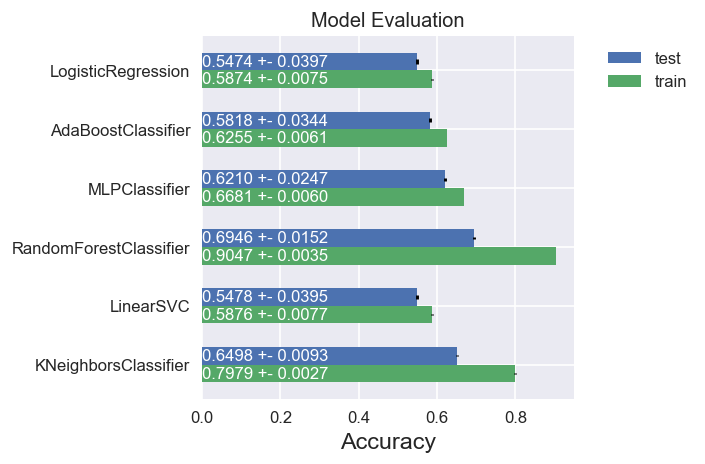

In [195]:
from kanbu.plot import learner_evaluation
mpl.rcParams["figure.dpi"]= 120
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(4, 4))

learner_evaluation(
    create_models(), test_scores, train_scores, ax, title="Model Evaluation"
)

In [182]:
def accuracy_detailed(classifier, X_test, y_test):
    conf_mat = confusion_matrix(y_test, classifier.predict(X_test))
    TP = conf_mat[0, 0]
    FN = conf_mat[1, 0]
    TN = conf_mat[1, 1]
    FP = conf_mat[0, 1]

    print(
        f"Accuracy score: {classifier.score(X_test, y_test)}",
        f"Sensetivity: {TP/ (TP + FN)}",
        f"Specificity: {TN / (TN + FP)}",
        sep="\n",
    )

    return {
        "acc_score": classifier.score(X_test, y_test),
        "sens": TP / (TP + FN),
        "spec": TN / (TN + FP),
    }

In [183]:
mlp_classifier = MLPClassifier(random_state=1, hidden_layer_sizes=(20, 60, 20))
mlp_classifier.fit(X, y)

/Users/ai/opt/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


MLPClassifier(hidden_layer_sizes=(20, 60, 20), random_state=1)

In [184]:
print("MLP Classifier (20, 60, 20) relu")
accuracy_detailed(mlp_classifier, X_test, y_test)

MLP Classifier (20, 60, 20) relu
Accuracy score: 0.5530304073120706
Sensetivity: 0.5170907040665305
Specificity: 0.5760690325058168


In [187]:
mlp_classifier_2 = MLPClassifier(random_state=1, hidden_layer_sizes=(20, 60, 20), activation="logistic")
mlp_classifier_2.fit(X, y)

MLPClassifier(activation='logistic', hidden_layer_sizes=(20, 60, 20),
              random_state=1)

In [190]:
print("MLP Classifier (20, 60, 20) logistic")
accuracy_detailed(mlp_classifier_2, X_test, y_test)

MLP Classifier (20, 60, 20) logistic
Accuracy score: 0.5128635731688852
Sensetivity: 0.47537419093851135
Specificity: 0.5576673213476356


In [193]:
knn = KNeighborsClassifier()

knn.fit(X, y)
print("K-Nearest Neighbours")
accuracy_detailed(knn, X_test, y_test)

K-Nearest Neighbours
Accuracy score: 0.5235591283879583
Sensetivity: 0.48160944812639384
Specificity: 0.5562852242097525


In [194]:
rf = RandomForestClassifier()

rf.fit(X, y)
print("Random Forests")
accuracy_detailed(rf, X_test, y_test)

Random Forests
Accuracy score: 0.5348465869203133
Sensetivity: 0.4944913525220503
Specificity: 0.5663675590860057


In [ ]:
fig = plt.figure(figsize=(5.8, 12))

# densities = []

for i, iax, n_neighbors in zip(range(9), range(1, 8, 2), [10, 20, 50, 100]):
    _, _, density = calculate_density(adatas[i])
#     densities.append(density)
    dens_x_wt = np.abs(np.minimum(density[:31659], 0))
    dens_x_sick = np.abs(np.minimum(density[31659:], 0))
    
#     dens_x = np.max(density, 0)
    df_wt_ = df_wt[dens_x_wt > 0.3]
    df_sick_ = df_sick[dens_x_sick > 0.3]
    dens_wt = dens_x_wt[dens_x_wt > 0.3]
    wens_sick = dens_x_sick[dens_x_sick > 0.3]
#     dens_x_wt = dens_x_wt[dens_x_wt > 0]
#     dens_x_sick = dens_x_sick[dens_x_sick > 0]
    
    ax_wt = fig.add_subplot(4, 2, iax)
    ax_sick = fig.add_subplot(4, 2, iax + 1)
    visualize_data(df_wt, f"WT     n_neighbors = {n_neighbors}", ax=ax_wt, legend_fontsize=3)
    visualize_data(df_sick, f"Sick    n_neighbors = {n_neighbors}", ax=ax_sick, legend_fontsize=3)
    ax_wt.scatter(df_wt_.x, df_wt_.y, c="red", s=dens_wt, alpha=0.5)
    ax_sick.scatter(df_sick_.x, df_sick_.y, c="red", s=wens_sick, alpha=0.5)